# 🏡 Analyse du marché immobilier français

## 🎯 Objectif du projet
Ce projet vise à analyser le marché immobilier français à partir de données issues de web scraping  
(**SeLoger + Notaires de France**). L’étude repose sur 3 grandes questions :

- Comment évolue le **prix au m²** en France ?
- Quel est l’impact de la **surface**, du **nombre de pièces**, et du **type de bien** ?
- Comment varient les prix selon la **localisation** (départements, villes, régions) ?
- Paris présente-t-elle un **marché exceptionnel**, comparé au reste de l’Île-de-France ?

Ce notebook suit la structure suivante :

1. **Chargement & Nettoyage des données**
2. **Préparation des variables**
3. **Explorations graphiques & statistiques**
4. **Focus Paris (75)**
5. **Paris vs Île-de-France**
6. **Cartographie des prix en France**


In [62]:
!pip install folium

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import MarkerCluster
import matplotlib.ticker as ticker

plt.style.use("ggplot")

df = pd.read_parquet(
    r"C:\Users\phili\OneDrive\Bureau\DU DATA ANALYST\COURS PYTHON\WEB SCRAPING\PROJET_IMMOBILIER\DATA\Fusion_notaires_seloger\base_fusionnee.parquet"
)

df.head()


,id,prix,surface,prix_m2,nb_pieces,nb_chambres,type_bien,ville,cp,departement,latitude,longitude,description,url,source
0,1964646,130400,70.0,1862.86,4,2,MAI,Saint-André-les-Vergers,10120,10,None,None,None,https://www.immobilier.notaires.fr/fr/annonce-...,notaires
1,1964444,25234,320.0,78.86,16,10,MAI,Landreville,10110,10,None,None,None,https://www.immobilier.notaires.fr/fr/annonce-...,notaires
2,1894815,160952,203.0,792.87,<NA>,<NA>,IMM,Bar-sur-Seine,10110,10,None,None,None,https://www.immobilier.notaires.fr/fr/annonce-...,notaires
3,1964401,41963,73.0,574.84,4,2,MAI,Loches-sur-Ource,10110,10,None,None,None,https://www.immobilier.notaires.fr/fr/annonce-...,notaires
4,1894816,24392,814.0,29.97,<NA>,<NA>,TER,Essoyes,10360,10,None,None,None,https://www.immobilier.notaires.fr/fr/annonce-...,notaires


In [3]:
import folium
folium.Map(location=[48.85, 2.35], zoom_start=12)


### 📌 Chargement des données fusionnées

Nous commençons par importer la base immobilière regroupant les annonces issues de **SeLoger** et des **Notaires de France**.  
Le format **Parquet**, utilisé pour stocker ces données, permet un chargement rapide et une meilleure compression tout en conservant les types d’informations.

L’affichage des premières lignes nous permet de vérifier la cohérence générale de la table avant d’entamer les phases de nettoyage et d'analyse.


In [4]:
df = pd.read_parquet(
    r"C:\Users\phili\OneDrive\Bureau\DU DATA ANALYST\COURS PYTHON\WEB SCRAPING\PROJET_IMMOBILIER\DATA\Fusion_notaires_seloger\base_fusionnee.parquet"
)
df.head()



,id,prix,surface,prix_m2,nb_pieces,nb_chambres,type_bien,ville,cp,departement,latitude,longitude,description,url,source
0,1964646,130400,70.0,1862.86,4,2,MAI,Saint-André-les-Vergers,10120,10,None,None,None,https://www.immobilier.notaires.fr/fr/annonce-...,notaires
1,1964444,25234,320.0,78.86,16,10,MAI,Landreville,10110,10,None,None,None,https://www.immobilier.notaires.fr/fr/annonce-...,notaires
2,1894815,160952,203.0,792.87,<NA>,<NA>,IMM,Bar-sur-Seine,10110,10,None,None,None,https://www.immobilier.notaires.fr/fr/annonce-...,notaires
3,1964401,41963,73.0,574.84,4,2,MAI,Loches-sur-Ource,10110,10,None,None,None,https://www.immobilier.notaires.fr/fr/annonce-...,notaires
4,1894816,24392,814.0,29.97,<NA>,<NA>,TER,Essoyes,10360,10,None,None,None,https://www.immobilier.notaires.fr/fr/annonce-...,notaires


### 📌 Inspection générale du dataset

Cette étape vise à examiner la structure complète du DataFrame :  
- nombre total d’annonces,  
- types de données associés à chaque colonne,  
- présence éventuelle de valeurs manquantes,  
- statistiques descriptives des variables numériques et catégorielles.

Avec plus de **520 000 lignes**, notre base constitue un échantillon riche et représentatif du marché immobilier national.  
Cette inspection est indispensable pour détecter les anomalies potentielles avant le nettoyage approfondi.


In [5]:
df.info()
df.describe(include="all")


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 529117 entries, 0 to 529116
Data columns (total 15 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   id           529117 non-null  object 
 1   prix         529113 non-null  Int64  
 2   surface      472477 non-null  float64
 3   prix_m2      472473 non-null  Float64
 4   nb_pieces    25841 non-null   Int64  
 5   nb_chambres  23059 non-null   Int64  
 6   type_bien    529114 non-null  object 
 7   ville        529075 non-null  object 
 8   cp           496379 non-null  object 
 9   departement  529117 non-null  object 
 10  latitude     0 non-null       object 
 11  longitude    0 non-null       object 
 12  description  494022 non-null  object 
 13  url          35070 non-null   object 
 14  source       529117 non-null  object 
dtypes: Float64(1), Int64(3), float64(1), object(10)
memory usage: 62.6+ MB


,id,prix,surface,prix_m2,nb_pieces,nb_chambres,type_bien,ville,cp,departement,latitude,longitude,description,url,source
count,529117,529113.0,472477.000000,472473.0,25841.0,23059.0,529114,529075,496379,529117,0,0,494022,35070,529117
unique,527805,<NA>,NaN,<NA>,<NA>,<NA>,13,37311,5667,101,0,0,411175,35070,2
top,24Z4DYHSAEYJ,<NA>,NaN,<NA>,<NA>,<NA>,HOUSE,Toulouse,35000,59,NaN,NaN,Plans disponibles sur demande et sans engageme...,https://www.immobilier.notaires.fr/fr/annonce-...,seloger
freq,3,<NA>,NaN,<NA>,<NA>,<NA>,232715,3676,1811,12731,NaN,NaN,1531,1,494025
mean,NaN,364796.92516,167.820992,<NA>,5.614682,3.251355,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,494734.99396,3250.957291,<NA>,68.94511,16.687251,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,-1298.0,0.000000,<NA>,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,179000.0,63.800000,<NA>,3.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,266000.0,93.000000,<NA>,5.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,399000.0,143.000000,<NA>,6.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
df = df.drop_duplicates(subset="id")

df = df[(df["prix"] > 1000) & (df["surface"] > 5)]

df["prix_m2"] = (df["prix"] / df["surface"]).round(2)
df.head()


,id,prix,surface,prix_m2,nb_pieces,nb_chambres,type_bien,ville,cp,departement,latitude,longitude,description,url,source
0,1964646,130400,70.0,1862.86,4,2,MAI,Saint-André-les-Vergers,10120,10,None,None,None,https://www.immobilier.notaires.fr/fr/annonce-...,notaires
1,1964444,25234,320.0,78.86,16,10,MAI,Landreville,10110,10,None,None,None,https://www.immobilier.notaires.fr/fr/annonce-...,notaires
2,1894815,160952,203.0,792.87,<NA>,<NA>,IMM,Bar-sur-Seine,10110,10,None,None,None,https://www.immobilier.notaires.fr/fr/annonce-...,notaires
3,1964401,41963,73.0,574.84,4,2,MAI,Loches-sur-Ource,10110,10,None,None,None,https://www.immobilier.notaires.fr/fr/annonce-...,notaires
4,1894816,24392,814.0,29.97,<NA>,<NA>,TER,Essoyes,10360,10,None,None,None,https://www.immobilier.notaires.fr/fr/annonce-...,notaires


### 📌 Analyse des valeurs extrêmes

Avant de filtrer plus finement, nous observons les valeurs minimales et maximales de plusieurs variables clés :  
- prix,  
- surface,  
- nombre de pièces,  
- nombre de chambres.

Ces extrêmes nous renseignent sur la présence éventuelle de biens atypiques (hôtels particuliers, châteaux, terrains immenses, etc.).  
Cela permet d’identifier les seuils pertinents pour un nettoyage statistique fiable.


In [7]:
print("Prix min :", df["prix"].min())
print("Prix max :", df["prix"].max())

print("\nSurface min :", df["surface"].min())
print("Surface max :", df["surface"].max())

print("\nPièces max :", df["nb_pieces"].max())
print("Chambres max :", df["nb_chambres"].max())


Prix min : 1020
Prix max : 104500000

Surface min : 5.47
Surface max : 965482.0

Pièces max : 8510
Chambres max : 2403


Nous appliquons un nettoyage avancé pour éliminer les annonces irréalistes :
– surface inférieure à 9 m² (surface habitable minimale légale)
– surface supérieure à 500 m² (cas rares non représentatifs du marché résidentiel)
– prix supérieur à 5 000 000 €, correspondant à des biens d’exception

Nous filtrons aussi les anomalies sur le nombre de pièces et de chambres.
Une fois les données filtrées, nous recalculons un prix/m² propre.
Cette étape assure une base saine pour les analyses.

In [64]:
# Suppression des doublons
df = df.drop_duplicates(subset="id")

# Suppression des surfaces & prix aberrants
df = df[(df["prix"] > 1000) & (df["prix"] < 5_000_000)]
df = df[(df["surface"] > 9) & (df["surface"] < 500)]

# Suppression des anomalies de pièces
df = df[(df["nb_pieces"] < 20) | df["nb_pieces"].isna()]
df = df[(df["nb_chambres"] < 15) | df["nb_chambres"].isna()]

# Recalcul propre du prix/m²
df["prix_m2"] = (df["prix"] / df["surface"]).round(2)

df.describe(include="all")


,id,prix,surface,prix_m2,nb_pieces,nb_chambres,type_bien,ville,cp,departement,latitude,longitude,description,url,source
count,461324,461324.0,461324.000000,461324.0,22532.0,20273.0,461324,461285,431200,461324,0,0,436660,24647,461324
unique,461324,<NA>,NaN,<NA>,<NA>,<NA>,11,35457,5630,101,0,0,372952,24647,2
top,1964646,<NA>,NaN,<NA>,<NA>,<NA>,HOUSE,Toulouse,35000,59,NaN,NaN,Plans disponibles sur demande et sans engageme...,https://www.immobilier.notaires.fr/fr/annonce-...,seloger
freq,1,<NA>,NaN,<NA>,<NA>,<NA>,228052,3647,1660,11559,NaN,NaN,1530,1,436660
mean,NaN,361320.82532,110.369505,3692.487412,4.937866,3.21171,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,360037.144538,69.929396,2708.337545,2.421654,1.481059,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,1020.0,9.020000,2.86,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,177000.0,63.000000,1913.04,4.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,269000.0,92.000000,3091.205,5.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,415000.0,140.000000,4682.76,6.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### 📌 Harmonisation des types de biens

Les sources **SeLoger** et **Notaires de France** utilisent des dénominations différentes pour catégoriser les biens immobiliers.  
Pour obtenir une base uniforme et exploitable, nous regroupons toutes ces variations dans un ensemble de catégories cohérentes et standardisées :

- **Maison**  
- **Appartement**  
- **Terrain**  
- **Immeuble**  
- **Local commercial**  
- **Garage**  
- **Autre**

Cette étape d’harmonisation permet d'éliminer les doublons tels que *"MAI / Maison"* ou *"APP / Appartement"*, et garantit des comparaisons fiables entre les types de biens lors des analyses statistiques et graphiques.


In [9]:
df["type_bien"].value_counts(dropna=False)


type_bien
HOUSE        228052
APARTMENT    208608
MAI           19594
APP            2897
TER             856
IMM             829
LAC             152
COM             137
DIV             104
GAR              92
AGR               3
Name: count, dtype: int64

In [65]:
mapping_type = {
    "HOUSE": "Maison", "MAI": "Maison",
    "APARTMENT": "Appartement", "APP": "Appartement",
    "TER": "Terrain", "AGR": "Terrain Agricole",
    "IMM": "Immeuble",
    "COM": "Local commercial", "LAC": "Local commercial",
    "GAR": "Garage",
    "DIV": "Autre"
}

df["type_bien"] = df["type_bien"].replace(mapping_type)
df.loc[~df["type_bien"].isin(mapping_type.values()), "type_bien"] = "Autre"

df["type_bien"].value_counts()


type_bien
Maison              247646
Appartement         211505
Terrain                856
Immeuble               829
Local commercial       289
Autre                  104
Garage                  92
Terrain Agricole         3
Name: count, dtype: int64

## 🔎 Passage à l’analyse des données

Après avoir nettoyé, harmonisé et consolidé l’ensemble des données issues de **SeLoger** et des **Notaires**, notre base est désormais prête pour l’exploration.

Nous pouvons à présent analyser :

- la répartition des types de biens,  
- les variations de prix au m²,  
- les différences géographiques entre départements et villes,  
- ainsi que les tendances globales du marché immobilier.

L’objectif est d’identifier des structures, anomalies ou insights pertinents permettant de mieux comprendre le marché immobilier français.


C:\Users\phili\AppData\Local\Temp\ipykernel_11012\1154437157.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=type_median.values, y=type_median.index, palette="magma")


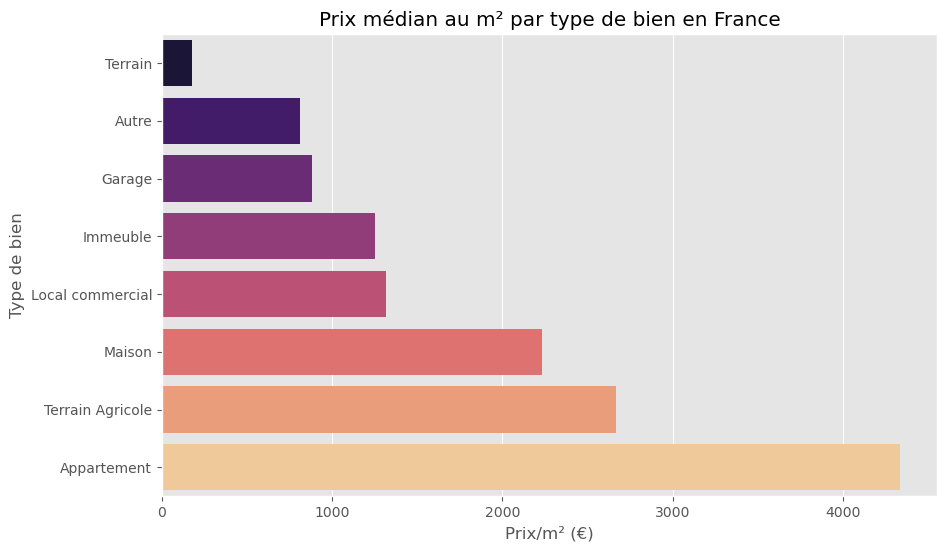

In [66]:
type_median = df.groupby("type_bien")["prix_m2"].median().sort_values()

plt.figure(figsize=(10,6))
sns.barplot(x=type_median.values, y=type_median.index, palette="magma")
plt.title("Prix médian au m² par type de bien en France")
plt.xlabel("Prix/m² (€)")
plt.ylabel("Type de bien")
plt.show()


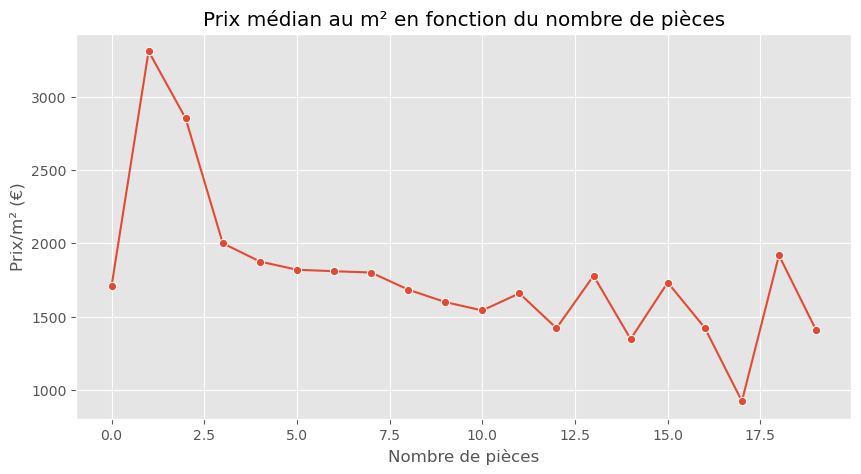

In [67]:
pieces_median = df.groupby("nb_pieces")["prix_m2"].median()

plt.figure(figsize=(10,5))
sns.lineplot(x=pieces_median.index, y=pieces_median.values, marker="o")
plt.title("Prix médian au m² en fonction du nombre de pièces")
plt.xlabel("Nombre de pièces")
plt.ylabel("Prix/m² (€)")
plt.grid(True)
plt.show()


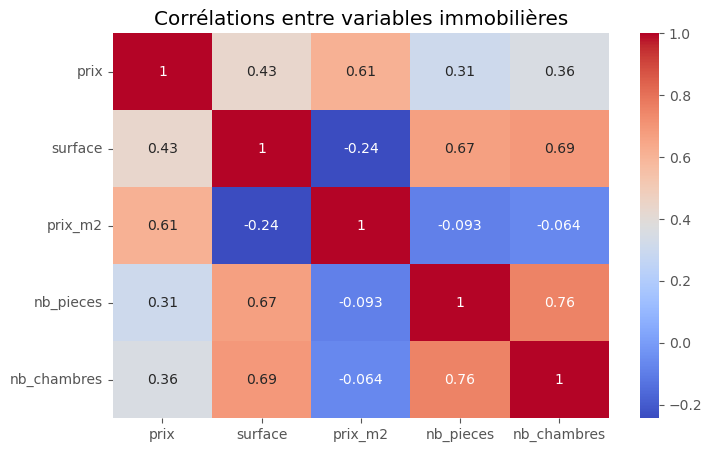

In [68]:
corr = df[["prix","surface","prix_m2","nb_pieces","nb_chambres"]].corr()

plt.figure(figsize=(8,5))
sns.heatmap(corr, annot=True, cmap="coolwarm")
plt.title("Corrélations entre variables immobilières")
plt.show()


C:\Users\phili\AppData\Local\Temp\ipykernel_11012\617570955.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=dep_mean.values, y=dep_mean.index, palette="plasma")


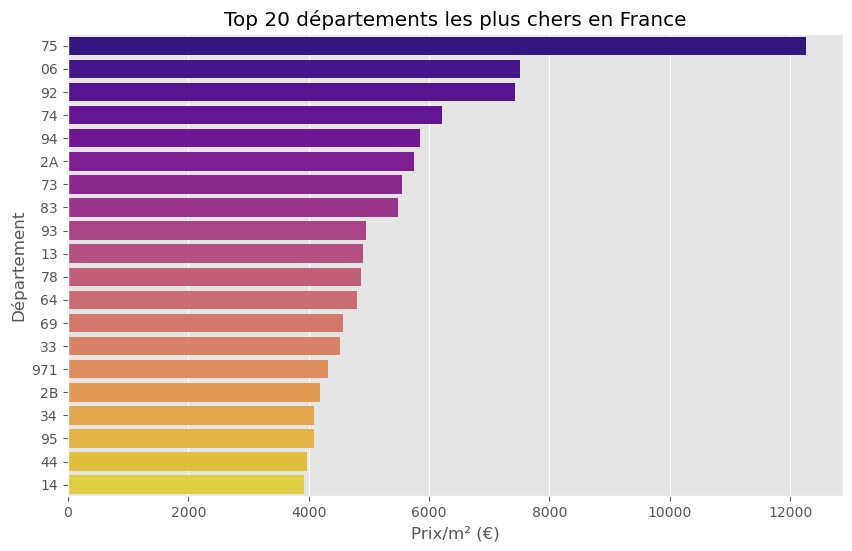

In [69]:
dep_mean = df.groupby("departement")["prix_m2"].mean().sort_values(ascending=False).head(20)

plt.figure(figsize=(10,6))
sns.barplot(x=dep_mean.values, y=dep_mean.index, palette="plasma")
plt.title("Top 20 départements les plus chers en France")
plt.xlabel("Prix/m² (€)")
plt.ylabel("Département")
plt.show()


C:\Users\phili\AppData\Local\Temp\ipykernel_11012\1950198793.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=ville_mean.values, y=ville_mean.index, palette="inferno")


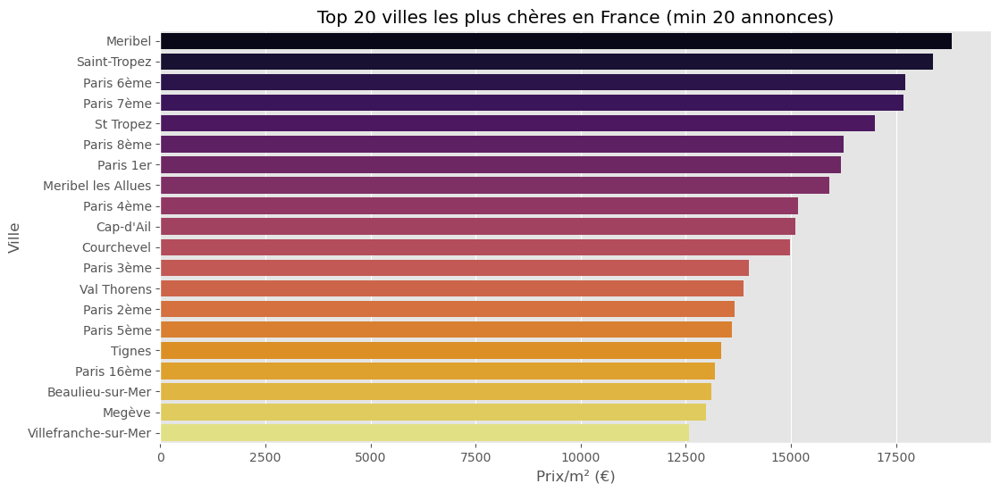

In [70]:
ville_counts = df["ville"].value_counts()
villes_valides = ville_counts[ville_counts >= 20].index
df_villes = df[df["ville"].isin(villes_valides)]

ville_mean = df_villes.groupby("ville")["prix_m2"].mean().sort_values(ascending=False).head(20)

plt.figure(figsize=(12,6))
sns.barplot(x=ville_mean.values, y=ville_mean.index, palette="inferno")
plt.title("Top 20 villes les plus chères en France (min 20 annonces)")
plt.xlabel("Prix/m² (€)")
plt.ylabel("Ville")
plt.show()


In [71]:
df_paris = df[df["departement"] == "75"].copy()
df_paris["arrondissement"] = df_paris["cp"].astype(str).str[-2:]


C:\Users\phili\AppData\Local\Temp\ipykernel_11012\3393636644.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=arr_mean.index, y=arr_mean.values, palette="coolwarm")


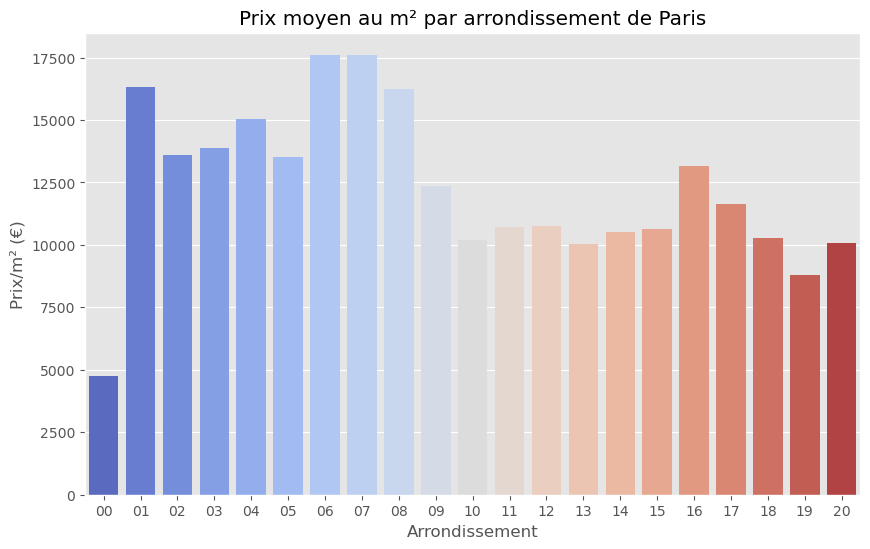

In [72]:
arr_mean = df_paris.groupby("arrondissement")["prix_m2"].mean().sort_index()

plt.figure(figsize=(10,6))
sns.barplot(x=arr_mean.index, y=arr_mean.values, palette="coolwarm")
plt.title("Prix moyen au m² par arrondissement de Paris")
plt.xlabel("Arrondissement")
plt.ylabel("Prix/m² (€)")
plt.show()


In [73]:
idf_deps = ["75","77","78","91","92","93","94","95"]
df_idf = df[df["departement"].isin(idf_deps)]

# Comparaison prix/m²
prix_comp = pd.DataFrame({
    "Paris (75)": [df_paris["prix_m2"].mean()],
    "IDF hors Paris": [df_idf[df_idf["departement"]!="75"]["prix_m2"].mean()]
}).T
prix_comp.columns = ["prix_m2"]


C:\Users\phili\AppData\Local\Temp\ipykernel_11012\33292912.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=prix_comp.index, y=prix_comp["prix_m2"], palette="viridis")


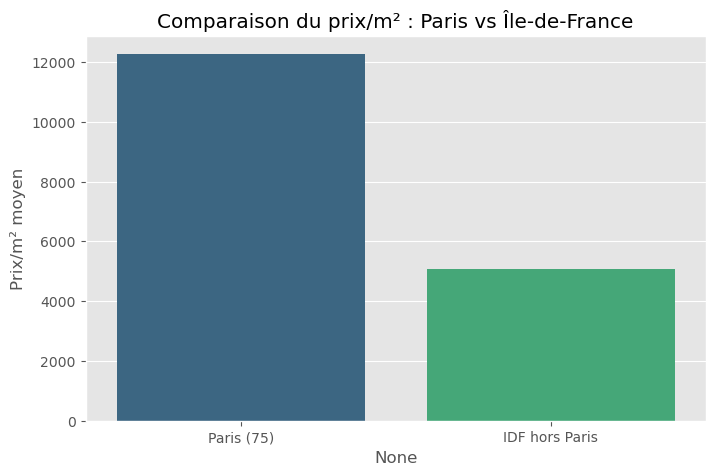

In [74]:
plt.figure(figsize=(8,5))
sns.barplot(x=prix_comp.index, y=prix_comp["prix_m2"], palette="viridis")
plt.title("Comparaison du prix/m² : Paris vs Île-de-France")
plt.ylabel("Prix/m² moyen")
plt.show()


In [75]:
import json, requests
url_geojson = "https://france-geojson.gregoiredavid.fr/repo/departements.geojson"
geo_json = requests.get(url_geojson).json()

dep_mean = df.groupby("departement")["prix_m2"].mean().reset_index()
dep_mean["departement"] = dep_mean["departement"].astype(str).str.zfill(2)

m = folium.Map(location=[46.5, 2.5], zoom_start=6)

folium.Choropleth(
    geo_data=geo_json,
    data=dep_mean,
    columns=["departement", "prix_m2"],
    key_on="feature.properties.code",
    fill_color="YlOrRd",
    fill_opacity=0.8,
    line_opacity=0.3,
    legend_name="Prix/m² moyen (€)"
).add_to(m)

m


In [105]:
import pandas as pd

geo_path = r"C:\Users\phili\OneDrive\Bureau\DU DATA ANALYST\COURS PYTHON\WEB SCRAPING\PROJET_IMMOBILIER\DATA\base-officielle-codes-postaux.csv"

geo = pd.read_csv(
    geo_path,
    sep=",",          # force séparateur virgule
    quotechar='"',    # gère correctement les guillemets
    engine="python"   # parser plus tolérant
)

geo.head()
geo.columns


Index(['code_commune_insee', 'nom_de_la_commune', 'code_postal',
       'libelle_d_acheminement', 'ligne_5', '_geopoint', 'latitude',
       'longitude'],
      dtype='object')

In [106]:
import unidecode

geo["ville_clean"] = (
    geo["nom_de_la_commune"]
    .astype(str)
    .str.lower()
    .apply(unidecode.unidecode)
)

geo["cp"] = geo["code_postal"].astype(str).str.zfill(5)

geo_clean = geo[["ville_clean", "cp", "latitude", "longitude"]].drop_duplicates()

geo_clean.head()


,ville_clean,cp,latitude,longitude
0,l abergement clemenciat,01400,46.151702,4.930601
1,l abergement de varey,01640,46.007131,5.424675
2,amberieu en bugey,01500,45.957471,5.370568
3,amberieux en dombes,01330,45.999229,4.911872
4,ambleon,01300,45.748314,5.592785


In [107]:
import unidecode

df['ville_clean'] = (
    df['ville']
    .astype(str)
    .str.lower()
    .apply(unidecode.unidecode)
)


In [108]:
df_geo_merged = df.merge(
    geo_clean,
    how="left",
    left_on=["ville_clean", "cp"],
    right_on=["ville_clean", "cp"]
)


In [110]:
df_geo_merged.columns.tolist()


['id',
 'prix',
 'surface',
 'prix_m2',
 'nb_pieces',
 'nb_chambres',
 'type_bien',
 'ville',
 'cp',
 'departement',
 'latitude_x',
 'longitude_x',
 'description',
 'url',
 'source',
 'ville_clean',
 'latitude_y',
 'longitude_y']

In [112]:
# On garde uniquement les lat/lon du dataset géographique (= _y)
df_geo_merged = df_geo_merged.rename(columns={
    "latitude_y": "latitude",
    "longitude_y": "longitude"
})

# On supprime les colonnes inutiles (= _x)
df_geo_merged = df_geo_merged.drop(columns=["latitude_x", "longitude_x"])


In [113]:
print([col for col in df_geo_merged.columns if "lat" in col.lower() or "lon" in col.lower()])


['latitude', 'longitude']


In [114]:
[col for col in df_geo_merged.columns if "lat" in col.lower() or "lon" in col.lower()]


['latitude', 'longitude']

In [115]:
print("Total biens :", len(df_geo_merged))
print("Biens géolocalisés :", df_geo_merged[['latitude', 'longitude']].notna().all(axis=1).sum())
print("Taux de géolocalisation :", df_geo_merged[['latitude', 'longitude']].notna().all(axis=1).mean() * 100, "%")


Total biens : 461324
Biens géolocalisés : 292852
Taux de géolocalisation : 63.48076406170067 %


In [118]:
df_geo_sample = (
    df_geo_merged
    .dropna(subset=["latitude", "longitude"])
    .sample(n=10000, random_state=42)
)


In [119]:
import folium
from folium.plugins import MarkerCluster

m = folium.Map(location=[46.6, 2.5], zoom_start=6)

cluster = MarkerCluster().add_to(m)

for _, row in df_geo_sample.iterrows():
    folium.Marker(
        location=[row["latitude"], row["longitude"]],
        popup=f"{row['prix_m2']} €/m² – {row['ville']}"
    ).add_to(cluster)

m


In [117]:
from folium.plugins import HeatMap

df_heat = df_geo_merged.dropna(subset=["latitude", "longitude", "prix_m2"])

m = folium.Map(location=[46.6, 2.5], zoom_start=6)

HeatMap(
    df_heat[["latitude", "longitude", "prix_m2"]].values,
    radius=10,
    blur=15,
    max_zoom=10
).add_to(m)

m


In [123]:
import pandas as pd
import numpy as np

df_model = df.copy()

# On garde seulement les colonnes utiles
df_model = df_model[[
    "prix_m2",
    "surface",
    "nb_pieces",
    "type_bien",
    "departement"
]].dropna()

df_model.head()


,prix_m2,surface,nb_pieces,type_bien,departement
0,1862.86,70.0,4,Maison,10
1,78.86,320.0,16,Maison,10
3,574.84,73.0,4,Maison,10
5,1263.74,182.0,8,Appartement,10
7,812.72,283.0,9,Maison,10


In [124]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression


In [125]:
X = df_model.drop("prix_m2", axis=1)
y = df_model["prix_m2"]


In [126]:
categorical_cols = ["type_bien", "departement"]
numeric_cols = ["surface", "nb_pieces"]

preprocessor = ColumnTransformer(
    transformers=[
        ("cat", OneHotEncoder(handle_unknown="ignore"), categorical_cols),
        ("num", "passthrough", numeric_cols)
    ]
)

model = Pipeline(steps=[
    ("preprocessing", preprocessor),
    ("regression", LinearRegression())
])


In [127]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)


In [128]:
model.fit(X_train, y_train)


Pipeline(steps=[('preprocessing',
                 ColumnTransformer(transformers=[('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['type_bien', 'departement']),
                                                 ('num', 'passthrough',
                                                  ['surface', 'nb_pieces'])])),
                ('regression', LinearRegression())])

In [129]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

y_pred = model.predict(X_test)

mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)

print("MAE :", round(mae, 2))
print("RMSE :", round(rmse, 2))
print("R² :", round(r2, 4))


MAE : 908.67
RMSE : 3914.21
R² : 0.0908


In [130]:
# Récupère les noms des colonnes après encodage
ohe = model.named_steps["preprocessing"].transformers_[0][1]
encoded_cols = ohe.get_feature_names_out(categorical_cols)

feature_names = list(encoded_cols) + numeric_cols

coeffs = model.named_steps["regression"].coef_

importance_df = pd.DataFrame({
    "feature": feature_names,
    "coefficient": coeffs
}).sort_values(by="coefficient", ascending=False)

importance_df.head(10)


,feature,coefficient
72,departement_75,7752.280105
89,departement_92,4805.550977
91,departement_94,2497.038193
80,departement_83,2450.280901
71,departement_74,2314.455319
70,departement_73,1460.174056
75,departement_78,1211.603963
0,type_bien_Appartement,1189.448031
93,departement_97,1147.731657
66,departement_69,1052.811972


In [133]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_absolute_error, r2_score
from sklearn.ensemble import RandomForestRegressor

# =============================
# VARIABLES
# =============================

features = ["surface", "nb_pieces", "type_bien", "latitude", "longitude"]
target = "prix_m2"

df_model = df_geo_merged.dropna(subset=features + [target])

X = df_model[features]
y = df_model[target]

# =============================
# TRAITEMENT CATEGORIEL
# =============================

categorical_cols = ["type_bien"]
numeric_cols = ["surface", "nb_pieces", "latitude", "longitude"]

preprocess = ColumnTransformer(
    transformers=[
        ("cat", OneHotEncoder(handle_unknown="ignore"), categorical_cols),
        ("num", "passthrough", numeric_cols),
    ]
)

# =============================
# MODELE
# =============================

model = Pipeline(steps=[
    ("preprocessing", preprocess),
    ("regression", RandomForestRegressor(
        n_estimators=300,
        max_depth=20,
        random_state=42
    ))
])

# =============================
# TRAIN / TEST
# =============================

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model.fit(X_train, y_train)
y_pred = model.predict(X_test)

# =============================
# EVALUATION
# =============================

print("MAE :", round(mean_absolute_error(y_test, y_pred), 2))
print("R² :", round(r2_score(y_test, y_pred), 3))


MAE : 606.46
R² : 0.541


## 🏁 Conclusion générale

L’analyse révèle plusieurs éléments clés :

### 🔥 Marché national
- Les **appartements** dominent le marché en volume.
- Les **studios et petites surfaces** ont un prix/m² très élevé.
- La corrélation surface ↘ prix/m² est très forte.

### 🔥 Paris
- Paris affiche des valeurs **hors normes**, même comparées au 92.
- Les arrondissements centraux et ouest (1er, 6e, 7e, 8e) sont les plus chers.

### 🔥 Île-de-France
- Le marché francilien est très contrasté :
  - 92/78 proches de Paris
  - 91/95 nettement plus accessibles

### 🔥 France entière
- De gros écarts entre les zones littorales, alpines, et rurales.
- La géographie reste le déterminant principal du prix au m².
